In [16]:
#IMPORTS 
import os
import glob
import shutil
import random
from tqdm import tqdm
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import cv2


import tensorflow as tf
# from tf_keras import layers
# from keras import layers
# from tf_keras.layers import Dropout, Flatten, Dense, MaxPooling2D
# from tf_keras.layers import Model
# from keras import preprocessing
# from tf_keras.preprocessing import ImageDataGenerator
from tensorflow.keras.applications.inception_v3 import InceptionV3
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dropout, Input, Flatten, Dense, MaxPooling2D
from tensorflow.keras.preprocessing.image import ImageDataGenerator

In [5]:
# Define the paths
dataset_path = 'C:\\r\\unsorted'  # Change this to the path of your MRLEyes folder
closed_folder = os.path.join('C:\\r\\data', 'closed')
open_folder = os.path.join('C:\\r\\data', 'open')

# Create directories if they don't exist
os.makedirs(closed_folder, exist_ok=True)
os.makedirs(open_folder, exist_ok=True)

In [13]:
if not (os.path.exists('C:\\r\\data\\train') and os.path.exists('C:\r\\data\\test')):
    # Setup paths
    TRAIN_PATH = os.path.join('data', 'train')
    TEST_PATH = os.path.join('data', 'test')
    # Make the directories

    os.makedirs(TRAIN_PATH,exist_ok=True)
    os.makedirs(TEST_PATH,exist_ok=True)
    added = 0

    for directory1 in os.listdir('mrlEyes_2018_01'):
        directory1_path = os.path.join('mrlEyes_2018_01', directory1)
        for file in os.listdir(directory1_path):
            file_path = os.path.join(directory1_path, file)
            if file.endswith('.png'):  # Adjust the file extension if necessary
                print(file)
                parts = file.split('_')
                print(parts)
                if len(parts) >= 3:
                    eye_state = parts[4]
                    print(eye_state)

                    # Determine the destination folder based on eye state
                    if eye_state == '0':
                        destination = 'closed'
                        print("closed")
                    elif eye_state == '1':
                        destination = "open"
                        print("open")
                    else:
                        continue  # Skip files with invalid format

                    # Construct the source and destination paths
                    EX_PATH = file_path
                    NEW_PATH = os.path.join('data', destination, file)
                    print(NEW_PATH)
                    
                    # Copy the file to the appropriate folder
                    try:
                        shutil.copy(EX_PATH, NEW_PATH)
                        print(f"Copied: {file} to {NEW_PATH}")
                        added += 1
                        print("Copied " + str(added) + "files.")
                    except FileNotFoundError as e:
                        print(f"Error: {e}")
                else:
                    print(f"Skipped: {file} due to invalid format")


s0001_00001_0_0_0_0_0_01.png
['s0001', '00001', '0', '0', '0', '0', '0', '01.png']
0
closed
data\closed\s0001_00001_0_0_0_0_0_01.png
Copied: s0001_00001_0_0_0_0_0_01.png to data\closed\s0001_00001_0_0_0_0_0_01.png
Copied 1files.
s0001_00002_0_0_0_0_0_01.png
['s0001', '00002', '0', '0', '0', '0', '0', '01.png']
0
closed
data\closed\s0001_00002_0_0_0_0_0_01.png
Copied: s0001_00002_0_0_0_0_0_01.png to data\closed\s0001_00002_0_0_0_0_0_01.png
Copied 2files.
s0001_00003_0_0_0_0_0_01.png
['s0001', '00003', '0', '0', '0', '0', '0', '01.png']
0
closed
data\closed\s0001_00003_0_0_0_0_0_01.png
Copied: s0001_00003_0_0_0_0_0_01.png to data\closed\s0001_00003_0_0_0_0_0_01.png
Copied 3files.
s0001_00004_0_0_0_0_0_01.png
['s0001', '00004', '0', '0', '0', '0', '0', '01.png']
0
closed
data\closed\s0001_00004_0_0_0_0_0_01.png
Copied: s0001_00004_0_0_0_0_0_01.png to data\closed\s0001_00004_0_0_0_0_0_01.png
Copied 4files.
s0001_00005_0_0_0_0_0_01.png
['s0001', '00005', '0', '0', '0', '0', '0', '01.png']
0

In [5]:
#divide open into training
source = 'C:\\r\\data\\open'
destination = 'C:\\r\\data\\train'
percent = 0.2

path, dirs, files_open = next(os.walk(source))
file_count_open = len(files_open)
percentage = file_count_open * percent
to_move = random.sample(glob.glob(source + "/*.png"), int(percentage))

for f in enumerate(to_move):
    if not os.path.exists(destination):
        os.makedirs(destination)
    shutil.move(f[1], destination)
print(f'moved {int(percentage)}')


moved 8590


In [6]:
#divide closed into training
source = 'C:\\HomeRepos\\M&TSI\\NNs\\data\\closed'
destination = 'C:\\HomeRepos\\M&TSI\\NNs\\data\\train'
percent = 0.2

path, dirs, files_open = next(os.walk(source))
file_count_open = len(files_open)
percentage = file_count_open * percent
to_move = random.sample(glob.glob(source + "/*.png"), int(percentage))

for f in enumerate(to_move):
    if not os.path.exists(destination):
        os.makedirs(destination)
    shutil.move(f[1], destination)
print(f'moved {int(percentage)}')


moved 8389


In [17]:
img_ = cv2.imread('C:\\HomeRepos\\M&TSI\\NNs\\data\\train\\s0001_00005_0_0_0_0_0_01.png',cv2.IMREAD_GRAYSCALE)

TypeError: Image data of dtype object cannot be converted to float

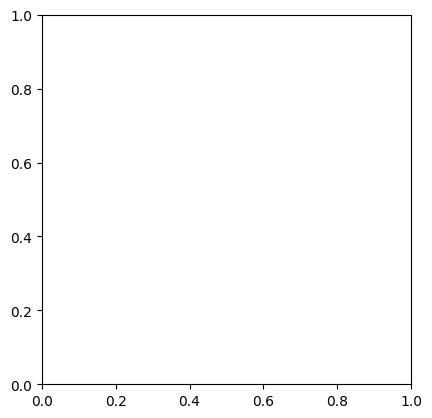

In [18]:
plt.imshow(img_,cmap='gray')

In [ ]:
img_.shape

(81, 81)

In [58]:
train_datagen= ImageDataGenerator(rescale=1/255, rotation_range=0.2,shear_range=0.2, zoom_range=0.2,width_shift_range=0.2, height_shift_range=0.2, validation_split=0.2)

train_data= train_datagen.flow_from_directory('data\\train', target_size=(80,80),batch_size=8,class_mode='categorical',subset='training' )
validation_data= train_datagen.flow_from_directory('data\\train', target_size=(80,80),batch_size=8,class_mode='categorical', subset='validation')

print(train_data)
print(validation_data)

Found 0 images belonging to 0 classes.
Found 0 images belonging to 0 classes.


In [65]:
import os 
os.getcwd()
os.listdir()
#os.chdir('train')


['s0001_00005_0_0_0_0_0_01.png',
 's0001_00020_0_0_0_0_0_01.png',
 's0001_00033_0_0_0_0_0_01.png',
 's0001_00034_0_0_0_0_0_01.png',
 's0001_00038_0_0_0_0_0_01.png',
 's0001_00042_0_0_0_0_0_01.png',
 's0001_00045_0_0_0_0_0_01.png',
 's0001_00049_0_0_0_0_0_01.png',
 's0001_00056_0_0_0_0_0_01.png',
 's0001_00064_0_0_0_0_0_01.png',
 's0001_00065_0_0_0_0_0_01.png',
 's0001_00074_0_0_0_0_0_01.png',
 's0001_00099_0_0_0_0_0_01.png',
 's0001_00100_0_0_0_0_0_01.png',
 's0001_00105_0_0_0_0_0_01.png',
 's0001_00119_0_0_0_0_0_01.png',
 's0001_00123_0_0_0_0_0_01.png',
 's0001_00125_0_0_0_0_0_01.png',
 's0001_00130_0_0_0_0_0_01.png',
 's0001_00141_0_0_0_0_0_01.png',
 's0001_00146_0_0_0_0_0_01.png',
 's0001_00152_0_0_0_0_0_01.png',
 's0001_00157_0_0_0_0_0_01.png',
 's0001_00159_0_0_0_0_0_01.png',
 's0001_00160_0_0_0_0_0_01.png',
 's0001_00163_0_0_0_0_0_01.png',
 's0001_00166_0_0_0_0_0_01.png',
 's0001_00169_0_0_0_0_0_01.png',
 's0001_00182_0_0_0_0_0_01.png',
 's0001_00185_0_0_0_0_0_01.png',
 's0001_00

In [ ]:
test_datagen = ImageDataGenerator(rescale=1./255)

In [ ]:
test_data = test_datagen.flow_from_directory('C:\\HomeRepos\\M&TSI\\NNs\\data\\test', target_size=(80,80),batch_size=8,class_mode='categorical')

Found 0 images belonging to 0 classes.


In [ ]:
bmodel = InceptionV3(include_top=False, weights='imagenet', input_tensor=Input(shape=(80,80,3)))
hmodel = bmodel.output
hmodel = Flatten()(hmodel)
hmodel = Dense(64, activation='relu')(hmodel)
hmodel = Dropout(0.5)(hmodel)
hmodel = Dense(2,activation= 'softmax')(hmodel)

model = Model(inputs=bmodel.input, outputs= hmodel)
for layer in bmodel.layers:
    layer.trainable = False

In [ ]:
bmodel.summary()

Model: "inception_v3"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_1       │ (None, 80, 80, 3) │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_94 (Conv2D)  │ (None, 39, 39,    │        864 │ input_layer_1[0]… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 39, 39,    │         96 │ conv2d_94[0][0]   │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_94       │ (None, 39, 39,    │          0 │ batch_normalizat… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_95 (Conv2D)  │ (None, 37, 37,    │      9,216 │ activation_94[0]… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 37, 37,    │         96 │ conv2d_95[0][0]   │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_95       │ (None, 37, 37,    │          0 │ batch_normalizat… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_96 (Conv2D)  │ (None, 37, 37,    │     18,432 │ activation_95[0]… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 37, 37,    │        192 │ conv2d_96[0][0]   │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_96       │ (None, 37, 37,    │          0 │ batch_normalizat… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_4     │ (None, 18, 18,    │          0 │ activation_96[0]… │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_97 (Conv2D)  │ (None, 18, 18,    │      5,120 │ max_pooling2d_4[… │
│                     │ 80)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 18, 18,    │        240 │ conv2d_97[0][0]   │
│ (BatchNormalizatio… │ 80)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_97       │ (None, 18, 18,    │          0 │ batch_normalizat… │
│ (Activation)        │ 80)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_98 (Conv2D)  │ (None, 16, 16,    │    138,240 │ activation_97[0]… │
│                     │ 192)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 16, 16,    │        576 │ conv2d_98[0][0]   │
│ (BatchNormalizatio… │ 192)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_98       │ (None, 16, 16,    │          0 │ batch_normalizat

 Total params: 21,802,784 (83.17 MB)

 Trainable params: 0 (0.00 B)

 Non-trainable params: 21,802,784 (83.17 MB)

In [ ]:
model.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_1       │ (None, 80, 80, 3) │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_94 (Conv2D)  │ (None, 39, 39,    │        864 │ input_layer_1[0]… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 39, 39,    │         96 │ conv2d_94[0][0]   │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_94       │ (None, 39, 39,    │          0 │ batch_normalizat… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_95 (Conv2D)  │ (None, 37, 37,    │      9,216 │ activation_94[0]… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 37, 37,    │         96 │ conv2d_95[0][0]   │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_95       │ (None, 37, 37,    │          0 │ batch_normalizat… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_96 (Conv2D)  │ (None, 37, 37,    │     18,432 │ activation_95[0]… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 37, 37,    │        192 │ conv2d_96[0][0]   │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_96       │ (None, 37, 37,    │          0 │ batch_normalizat… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_4     │ (None, 18, 18,    │          0 │ activation_96[0]… │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_97 (Conv2D)  │ (None, 18, 18,    │      5,120 │ max_pooling2d_4[… │
│                     │ 80)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 18, 18,    │        240 │ conv2d_97[0][0]   │
│ (BatchNormalizatio… │ 80)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_97       │ (None, 18, 18,    │          0 │ batch_normalizat… │
│ (Activation)        │ 80)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_98 (Conv2D)  │ (None, 16, 16,    │    138,240 │ activation_97[0]… │
│                     │ 192)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 16, 16,    │        576 │ conv2d_98[0][0]   │
│ (BatchNormalizatio… │ 192)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_98       │ (None, 16, 16,    │          0 │ batch_normalizat

 Total params: 21,934,050 (83.67 MB)

 Trainable params: 131,266 (512.76 KB)

 Non-trainable params: 21,802,784 (83.17 MB)

In [ ]:
from tensorflow.keras.callbacks import ModelCheckpoint,EarlyStopping, ReduceLROnPlateau

In [ ]:
checkpoint = ModelCheckpoint(r'C:\Users\Jay\Desktop\dds\models\model1',
                            monitor='val_loss',save_best_only=True,verbose=3)

earlystop = EarlyStopping(monitor = 'val_loss', patience=5, verbose= 3, restore_best_weights=True)

learning_rate = ReduceLROnPlateau(monitor= 'val_loss', patience=3, verbose= 3)

callbacks=[checkpoint,earlystop,learning_rate]